# Load data 



In [1]:
import pandas as pd
import numpy as np
import pylab
%matplotlib inline

import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

df = pd.read_csv("../data/20180220-wikia_stats_users.csv")
df.drop_duplicates(subset=['url'], inplace=True)
df.head()

,url,domain,hub,id,lang,language,name,stats.activeUsers,stats.admins,stats.articles,...,topic,wam_score,stats.nonarticles,users_1,users_5,users_10,users_20,users_50,users_100,bots
0,http://0ad.wikia.com/,0ad.wikia.com,Games,194794.0,en,en,0 A.D. Wiki,1.0,3.0,101.0,...,Gaming,2.4465,824.0,38,20,14,9,7,5,8
1,http://0hourmysticknights.wikia.com/,0hourmysticknights.wikia.com,Games,1459872.0,en,en,0 Hour: Mystic Knights Wikia,0.0,1.0,22.0,...,Creative,0.0000,139.0,7,6,3,1,1,1,4
2,http://0-xxii.wikia.com/,0-xxii.wikia.com,Games,685186.0,en,en,0-XXII Wiki,0.0,1.0,34.0,...,Creative,0.0000,262.0,5,3,3,2,2,1,3
3,http://00fanon.wikia.com/,00fanon.wikia.com,TV,350933.0,en,en,00 Fanon Wiki,1.0,1.0,93.0,...,Fanon,0.0000,257.0,5,2,1,1,1,1,3
4,http://0002oifos.wikia.com/,0002oifos.wikia.com,Games,678685.0,en,en,0002oifos Wiki,0.0,1.0,6.0,...,TV,0.0000,263.0,3,1,1,1,1,1,2


In [2]:
def describeMetric(df, metric):
    print(df[metric].describe())
    print("90%: {}".format(df[metric].quantile(0.9)))
    print("95%: {}".format(df[metric].quantile(0.95)))
    print("99%: {}".format(df[metric].quantile(0.99)))

# Content stats

- `stats.pages` refers to all pages in the wiki, including articles, talk pages, redirects, etc.
- `stats.articles` refers to the number of content pages in the wiki.

## Pages


In [3]:
describeMetric(df, 'stats.pages')

count    3.389490e+05
mean     8.348895e+02
std      1.506162e+04
min      1.000000e+00
25%      1.050000e+02
50%      1.960000e+02
75%      2.600000e+02
max      2.488274e+06
Name: stats.pages, dtype: float64
90%: 498.0
95%: 1065.0
99%: 7910.520000000019


## Articles

In [4]:
describeMetric(df, 'stats.articles')

count    3.389490e+05
mean     9.926966e+01
std      4.820160e+03
min      0.000000e+00
25%      5.000000e+00
50%      9.000000e+00
75%      2.300000e+01
max      2.216232e+06
Name: stats.articles, dtype: float64
90%: 77.0
95%: 177.0
99%: 1026.0


# User stats

In [5]:
describeMetric(df,'users_1')

count    338949.000000
mean         22.213407
std         408.673679
min           0.000000
25%           4.000000
50%           5.000000
75%           7.000000
max      111795.000000
Name: users_1, dtype: float64
90%: 16.0
95%: 31.0
99%: 210.0


# Edit stats

In [6]:
describeMetric(df, 'stats.edits')

count    3.389490e+05
mean     2.163446e+03
std      5.498577e+04
min      1.000000e+00
25%      1.260000e+02
50%      2.400000e+02
75%      3.910000e+02
max      2.150603e+07
Name: stats.edits, dtype: float64
90%: 1102.0
95%: 2692.0
99%: 22299.040000000037


## Edits per page

In [7]:
df['editsperpage'] = df['stats.edits'] / df['stats.pages']

In [8]:
describeMetric(df, 'editsperpage')

count    338949.000000
mean          1.640526
std           2.322536
min           1.000000
25%           1.086957
50%           1.222628
75%           1.617089
max         356.600000
Name: editsperpage, dtype: float64
90%: 2.3957551142079967
95%: 3.2337225609583897
99%: 6.91044776119403


# Distribution by language

In [9]:
groupByLanguage = df.groupby(by="lang")
byLanguage = groupByLanguage.id.count()
byLanguage.sort_values(ascending=False, inplace=True)
byLanguage

lang
en         240398
es          31248
ru          14486
de          11759
pl           7997
fr           6881
pt-br        6040
it           3576
zh           2382
nl           1699
pt           1479
ja           1227
ko           1207
fi            875
tr            803
vi            686
hu            576
sv            539
id            518
cs            506
uk            323
th            315
he            299
ro            289
da            265
no            262
el            246
zh-tw         202
ca            195
ar            183
            ...  
nso             1
om              1
pa              1
pag             1
pie             1
rmy             1
prg             1
kw              1
ku              1
ksh             1
tg-cyrl         1
tt-latn         1
ts              1
to              1
fr-ca           1
frp             1
gd              1
tn              1
gv              1
ht              1
kr              1
ia              1
ig              1
inh             1
io   

In [10]:
def langOther(x):
    if x in byLanguage.index[:8].values:
        return x
    else:
        return 'other'
    
byLanguage.index[:8]
df['language'] = df['lang']
df['language'] = df['language'].apply(langOther)

In [11]:
byReducedLanguage = df.groupby(by="language").id.count()
byReducedLanguage.sort_values(ascending=False, inplace=True)
byReducedLanguage

language
en       240398
es        31248
other     16564
ru        14486
de        11759
pl         7997
fr         6881
pt-br      6040
it         3576
Name: id, dtype: int64

In [12]:
values = byReducedLanguage.values
values = 100*(values/values.sum())


data = [go.Bar(
            x=values,
            y=byReducedLanguage.index.values,
            orientation = 'h'
)]

annotations = [dict(
            x=x+8,
            y=y,
            xref='x',
            yref='y',
            text='{0:.2f}%'.format(x),
            showarrow=False
        ) for (x,y) in zip(values, list(range(0,len(values))))]

layout = go.Layout(
    xaxis=dict(
        range=[0,101],
        domain=[0,0.5],
        tickfont=dict(
            size=14,
        ),
        #showline=True
    ),
    yaxis=dict(
        tickfont=dict(
            size=14,
        ),
        ticksuffix=" "
    ),
    annotations = annotations
);


iplot(go.Figure(data= data, layout=layout), filename="byLanguage")

# Distribution by hub category

Hub categories are defined by Wikia

In [13]:
groupByHub = df.groupby(by="hub")
byHub = groupByHub.id.count()
byHub.sort_values(ascending=False, inplace=True)
byHub

hub
Games        121306
Lifestyle     93717
TV            51050
Books         23879
Comics        16031
Movies        15203
Music         10001
Other          7762
Name: id, dtype: int64

In [14]:
values = byHub.values
values = 100*(values/values.sum())


data = [go.Bar(
            x=values,
            y=byHub.index.values,
            orientation = 'h'
)]

annotations = [dict(
            x=x+8,
            y=y,
            xref='x',
            yref='y',
            text='{0:.2f}%'.format(x),
            showarrow=False
        ) for (x,y) in zip(values, list(range(0,len(values))))]

layout = go.Layout(
    xaxis=dict(
        range=[0,101],
        domain=[0,0.5],
        tickfont=dict(
            size=14,
        ),
        #showline=True
    ),
    yaxis=dict(
        tickfont=dict(
            size=14,
        ),
        ticksuffix=" "
    ),
    annotations = annotations
);


iplot(go.Figure(data= data, layout=layout), filename="byHub")

# Analysis of Active and Inactive wikis

**Active wikis** are the ones with at least 1 user (`user_1`) and at least 1 active user in the previous 30 days (`stats.activeUsers`)


In [15]:
threshold = 1
totalWikis = len(df) 
deadWikis = df[(df['stats.activeUsers']<threshold)|(df['users_1']==0)]
print ("Dead Wikis: {} ({:05.2f}%)".format(len(deadWikis), 100*len(deadWikis)/totalWikis))

Dead Wikis: 235391 (69.45%)


In [16]:
aliveWikis = df[(df['stats.activeUsers']>=threshold)&(df['users_1']>0)]
print ("Alive Wikis: {} ({:05.2f}%)".format(len(aliveWikis), 100*len(aliveWikis)/totalWikis))
print("With less than 5 articles: {}".format(len(aliveWikis[aliveWikis['stats.articles']<5])))
print("With less than 24 pages: {}".format(len(aliveWikis[aliveWikis['stats.pages']<24])))
print("With less than 4 users: {}".format(len(aliveWikis[aliveWikis['users_1']<4])))

Alive Wikis: 103558 (30.55%)
With less than 5 articles: 20456
With less than 24 pages: 418
With less than 4 users: 7020


## Scatterplot of the number of users over the number of articles, distinguishing between active wikis (green) and inactive wikis (black)

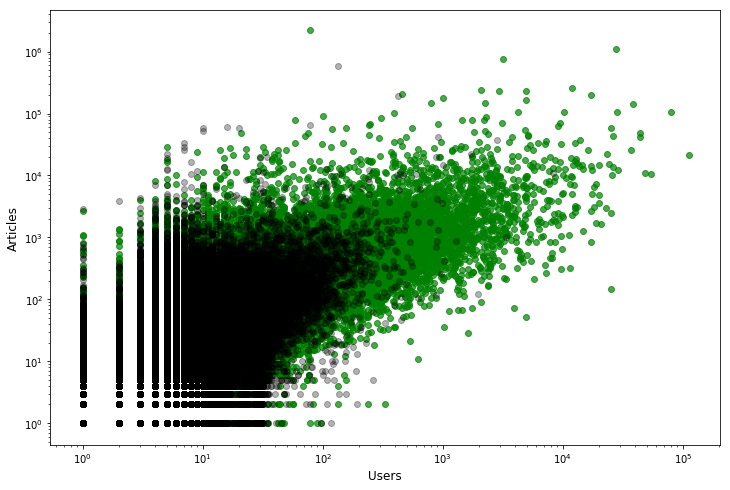

In [17]:
fig = pylab.figure(figsize=(12,8))
ax = pylab.gca()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Users', {'size': 'large'})
ax.set_ylabel('Articles', {'size': 'large'})
ax.scatter(aliveWikis['users_1'].values,aliveWikis['stats.articles'].values, c='g',alpha=0.7)
ax.scatter(deadWikis['users_1'].values,deadWikis['stats.articles'].values, c='black', alpha=0.3)

## Scatterplot of the number of users over the number of edits, distinguishing between active wikis (green) and inactive wikis (black)


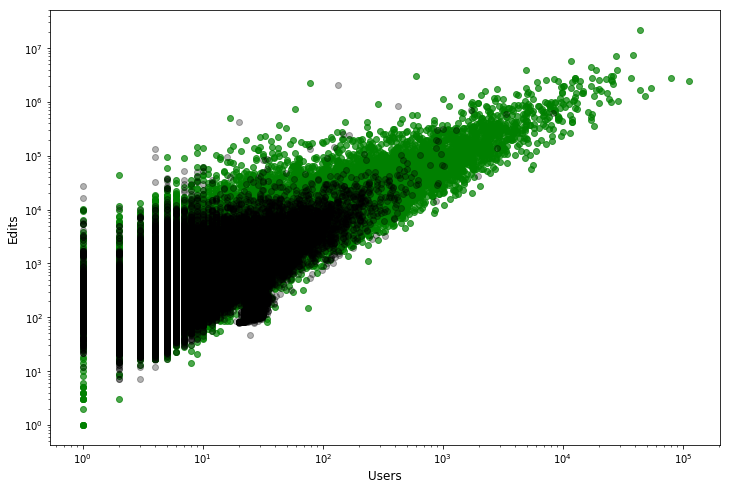

In [18]:
fig = pylab.figure(figsize=(12,8))
ax = pylab.gca()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Users', {'size': 'large'})
ax.set_ylabel('Edits', {'size': 'large'})
ax.scatter(aliveWikis['users_1'].values,aliveWikis['stats.edits'].values, c='g',alpha=0.7)
ax.scatter(deadWikis['users_1'].values,deadWikis['stats.edits'].values, c='black', alpha=0.3)

## Scatterplot of the number of articles over the number of edits, distinguishing between active wikis (green) and inactive wikis (black)

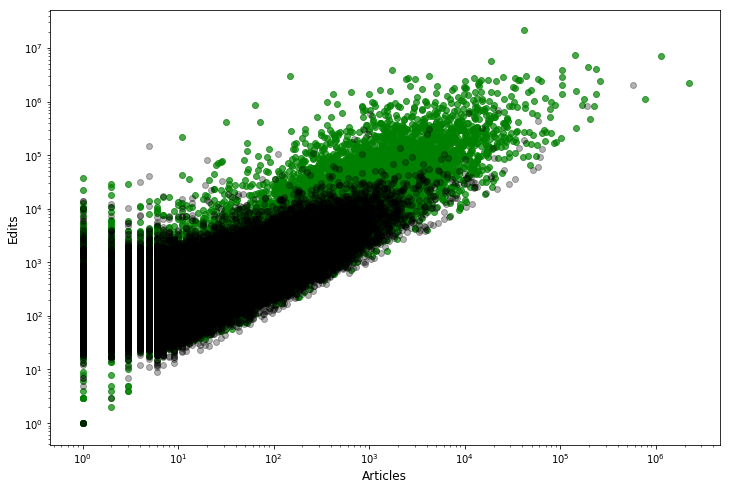

In [19]:
fig = pylab.figure(figsize=(12,8))
ax = pylab.gca()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Articles', {'size': 'large'})
ax.set_ylabel('Edits', {'size': 'large'})
ax.scatter(aliveWikis['stats.articles'].values,aliveWikis['stats.edits'].values, c='g',alpha=0.7)
ax.scatter(deadWikis['stats.articles'].values,deadWikis['stats.edits'].values, c='black', alpha=0.3)

## Cummulative of wikis having at least U users

In [20]:
histAlive, binsAlive = np.histogram(aliveWikis[['users_1']],bins=int(aliveWikis[['users_1']].max()))
yAlive = np.cumsum(histAlive[::-1])[::-1]

histDead, binsDead = np.histogram(deadWikis[['users_1']],bins=int(deadWikis[['users_1']].max()))
yDead = np.cumsum(histDead[::-1])[::-1]

In [21]:
data = [
    go.Scattergl(
        x=binsAlive[0:len(binsAlive)-1],
        y=yAlive,     
        mode='markers',
        name="Active wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='green',
            size=8
        )
    ),
    go.Scattergl(
        x=binsDead[0:len(binsDead)-1],
        y=yDead, 
        mode='markers',
        name="Inactive wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='black',
            size=8
        )
    )
]

layout = go.Layout(
    xaxis=dict(
        type='log',
        autorange=True,
        domain=[0,0.5],
        exponentformat="power",
        title="At least U users"
    ),
    yaxis=dict(
        type='log',
        autorange=True,
        exponentformat="power",
        title="Number of wikis"
    ),
    legend=dict(
        x=0.3,
        y=0.9
    )
)

iplot(go.Figure(data= data, layout=layout))

## Cummulative of wikis having at least E edits


In [22]:
histAlive, binsAlive = np.histogram(aliveWikis[['stats.edits']],bins= 100000)#int(aliveWikis[['stats.edits']].max()))
yAlive = np.cumsum(histAlive[::-1])[::-1]

histDead, binsDead = np.histogram(deadWikis[['stats.edits']],bins=100000)#int(deadWikis[['stats.edits']].max()))
yDead = np.cumsum(histDead[::-1])[::-1]

In [23]:
data = [
    go.Scattergl(
        x=binsAlive[0:len(binsAlive)-1],
        y=yAlive,     
        mode='markers',
        name="Active wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='green',
            size=8
        )
    ),
    go.Scattergl(
        x=binsDead[0:len(binsDead)-1],
        y=yDead, 
        mode='markers',
        name="Inactive wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='black',
            size=8
        )
    )
]

layout = go.Layout(
    xaxis=dict(
        type='log',
        autorange=True,
        domain=[0,0.5],
        exponentformat="power",
        title="At least E edits"
    ),
    yaxis=dict(
        type='log',
        autorange=True,
        exponentformat="power",
        title="Number of wikis"
    ),
    legend=dict(
        x=0.3,
        y=0.9
    )
)

iplot(go.Figure(data= data, layout=layout))

## Cummulative of wikis having at least P articles

In [24]:
histAlive, binsAlive = np.histogram(aliveWikis[['stats.articles']],bins= 100000)#int(aliveWikis[['stats.articles']].max()))
yAlive = np.cumsum(histAlive[::-1])[::-1]

histDead, binsDead = np.histogram(deadWikis[['stats.articles']],bins=100000)#int(deadWikis[['stats.articles']].max()))
yDead = np.cumsum(histDead[::-1])[::-1]

In [25]:
data = [
    go.Scattergl(
        x=binsAlive[0:len(binsAlive)-1],
        y=yAlive,     
        mode='markers',
        name="Active wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='green',
            size=8
        )
    ),
    go.Scattergl(
        x=binsDead[0:len(binsDead)-1],
        y=yDead, 
        mode='markers',
        name="Inactive wikis",
        marker=dict(
            symbol='circle',
            opacity=0.7,
            color='black',
            size=8
        )
    )
]

layout = go.Layout(
    xaxis=dict(
        type='log',
        autorange=True,
        domain=[0,0.5],
        exponentformat="power",
        title="At least P articles"
    ),
    yaxis=dict(
        type='log',
        autorange=True,
        exponentformat="power",
        title="Number of wikis"
    ),
    legend=dict(
        x=0.3,
        y=0.9
    )
)

iplot(go.Figure(data= data, layout=layout), filename="edits-cumsum")